In [1]:
import os
import sys

def add_path():
    path = os.path.abspath(os.path.join(os.getcwd(), "../"))
    if path not in sys.path:
        sys.path.append(path)
    
    path = os.path.abspath(os.path.join(os.getcwd(), "../../"))
    if path not in sys.path:
        sys.path.append(path)

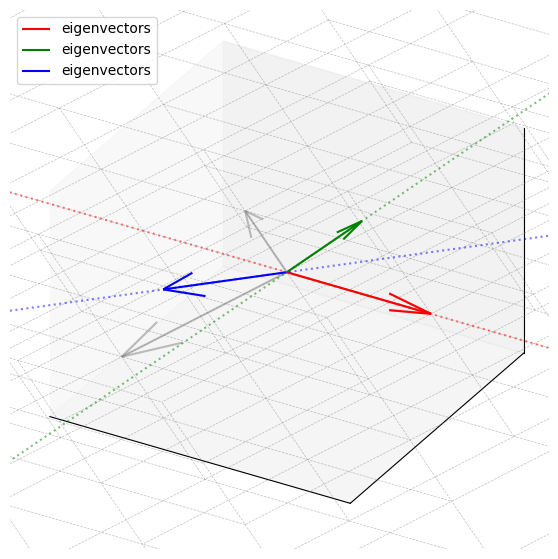

In [53]:
add_path()
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
from intuitive_understanding_of_linear_algebra.src import utils

standard_basis = np.eye(3)

matrix_a = np.array(
    [
        [2, -2, 0],
        [0, -0.5, -1],
        [0, -2, 1.8],
    ]
)

_, eigenvectors = np.linalg.eig(matrix_a)

fig = plt.figure(figsize=(7, 7))

ax = fig.add_subplot(111, projection="3d")
ax.set_proj_type("ortho")

xlim = (-2, 2)
ylim = (-2, 2)
zlim = (-2, 2)

def update(frame):
    ax.clear()
    
    t = frame / 100
    interpolated = (1 - t) * standard_basis + t * matrix_a
    
    utils.plot_full_custom_3d_grid(ax, interpolated.T, xlim, ylim, zlim, alpha=0.5)
    
    e1 = ax.quiver(0, 0, 0, interpolated[0][0], interpolated[1][0], interpolated[2][0], color="gray", arrow_length_ratio=0.3, alpha=0.5)
    e2 = ax.quiver(0, 0, 0, interpolated[0][1], interpolated[1][1], interpolated[2][1], color="gray", arrow_length_ratio=0.3, alpha=0.5)
    e3 = ax.quiver(0, 0, 0, interpolated[0][2], interpolated[1][2], interpolated[2][2], color="gray", arrow_length_ratio=0.3, alpha=0.5)
    
    colors = ["r", "g", "b"]
    updated = []
    for evi, eigenvector in enumerate((interpolated @ eigenvectors).T):
        eigquiver = ax.quiver(0, 0, 0, eigenvector[0], eigenvector[1], eigenvector[2], label="eigenvectors", color=colors[evi], arrow_length_ratio=0.3)
        
        ray = eigenvector * 10000
        ray_positive = ax.quiver(0, 0, 0, ray[0], ray[1], ray[2], color=colors[evi], alpha=0.5, linestyle="dotted")
        ray_negative = ax.quiver(0, 0, 0, -ray[0], -ray[1], -ray[2], color=colors[evi], alpha=0.5, linestyle="dotted")
        
        updated += [eigquiver, ray_positive, ray_negative]
    
    updated += [e1, e2, e3]
    
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_zlim(zlim)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.set_aspect("auto")
    ax.legend(loc="upper left")
    
    return updated

ani = animation.FuncAnimation(fig, update, frames=101, blit=True)

html_str = ani.to_jshtml()
with open(os.path.join(os.getcwd(), "../animations/eigenvalues-and-eigenvectors-1.html"), "w") as f:
    f.write(html_str)

HTML(html_str)